### Display RGB Image color channels in 3D

/var/folders/9v/jr20lh896vggl5_25dthcsw80000gn/T/ipykernel_11574/410250015.py:15: MatplotlibDeprecationWarning: Calling gca() with keyword arguments was deprecated in Matplotlib 3.4. Starting two minor releases later, gca() will take no keyword arguments. The gca() function should only be used to get the current axes, or if no axes exist, create new axes with default keyword arguments. To create a new axes with non-default arguments, use plt.axes() or plt.subplot().
  ax = fig.gca(projection='3d')


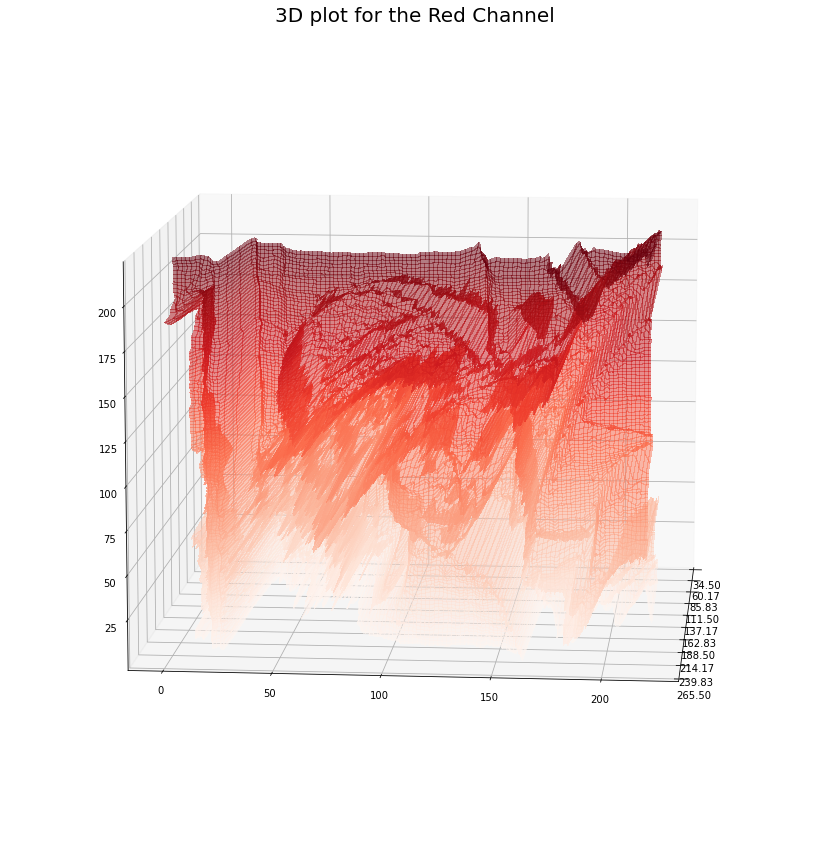

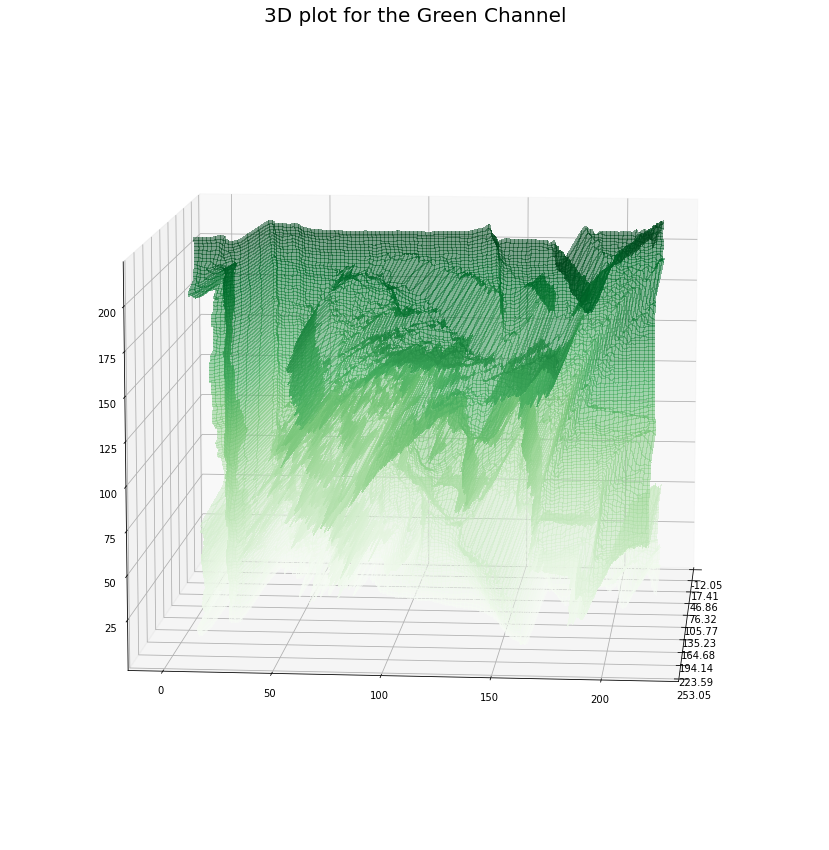

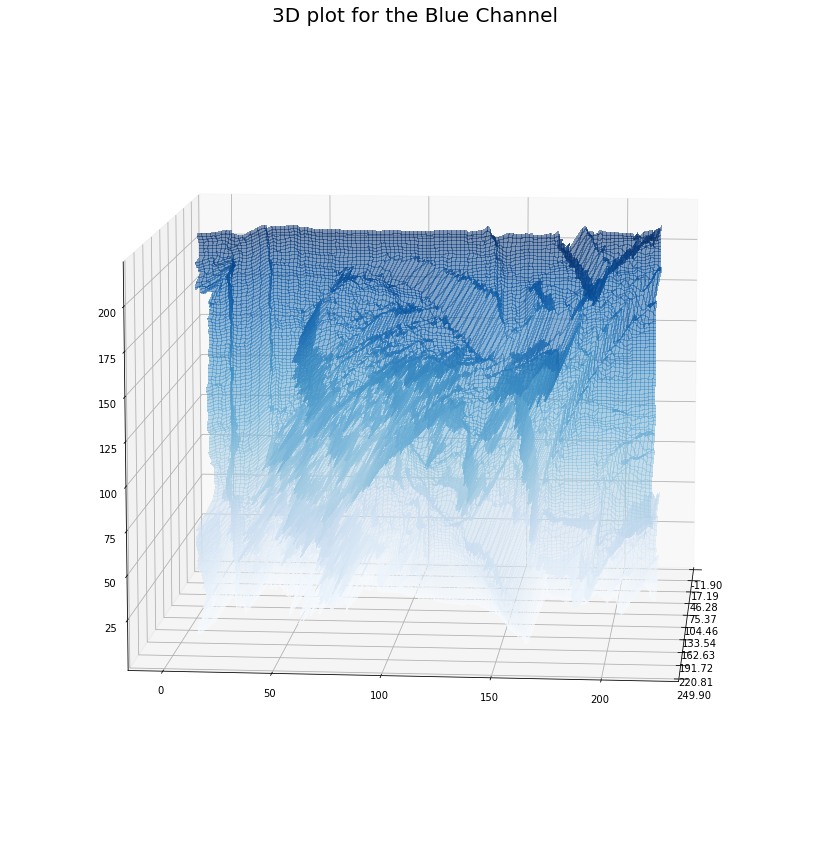

In [3]:
from skimage.io import imread
import numpy as np
import matplotlib.pylab as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import cm
from matplotlib.ticker import LinearLocator, FormatStrFormatter

def plot_3d(X, Y, Z, cmap='Reds', title=''):
    """
    This function plots 3D visualization of a channel
    It displays (x, y, f(x,y)) for all x,y values
    """ 

    fig = plt.figure(figsize=(15,15))
    ax = fig.gca(projection='3d')
    # Plot the surface.
    surf = ax.plot_surface(X, Y, Z, cmap=cmap, linewidth=0, antialiased=False, rstride=2, cstride=2, alpha=0.5)
    ax.xaxis.set_major_locator(LinearLocator(10))
    ax.xaxis.set_major_formatter(FormatStrFormatter('%.02f'))
    ax.view_init(elev=10., azim=5)
    ax.set_title(title, size=20)
    plt.show()

im = imread('images/Chapter 01/Figure 1.jpg')

Y = np.arange(im.shape[0])
X = np.arange(im.shape[1])
X, Y = np.meshgrid(X, Y)

Z1 = im[...,0]
Z2 = im[...,1]
Z3 = im[...,2]

plot_3d(Z1, X, im.shape[1]-Y, cmap='Reds', title='3D plot for the Red Channel')

plot_3d(Z2, X, im.shape[1]-Y, cmap='Greens', title='3D plot for the Green Channel')

plot_3d(Z3, X, im.shape[1]-Y, cmap='Blues', title='3D plot for the Blue Channel')

## 2.  Video I/O

### 2.1 Read/Write Video Files with scikit-video

600 916 1920 3


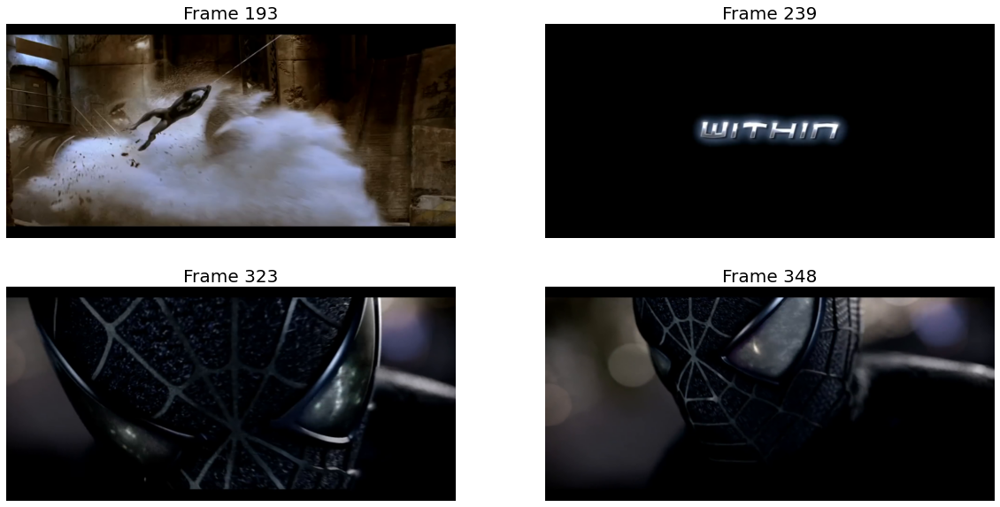

In [2]:
import skvideo.io
import numpy as np
import matplotlib.pylab as plt

inputparameters = {}
outputparameters = {}
reader = skvideo.io.FFmpegReader('images/Chapter 01/Vid_01_01.mp4',
                inputdict=inputparameters,
                outputdict=outputparameters)

## Read video file
num_frames, height, width, num_channels = reader.getShape()
print(num_frames, height, width, num_channels)

plt.figure(figsize=(20,10))

frame_list = np.random.choice(num_frames, 4)
i, j = 0, 1
for frame in reader.nextFrame():
    if i in frame_list:
        plt.subplot(2,2,j)
        plt.imshow(frame)
        plt.title("Frame {}".format(i), size=20)
        plt.axis('off')
        j += 1
    i += 1
plt.show()

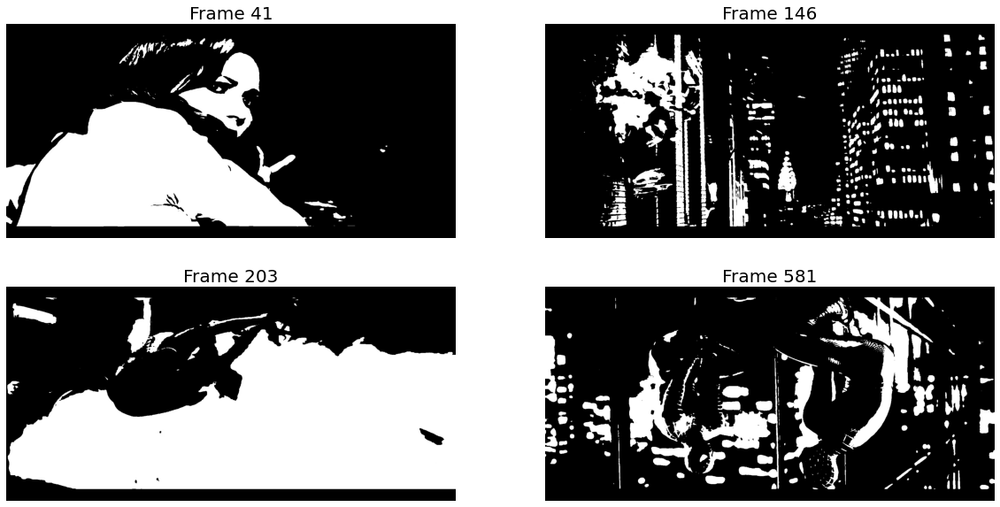

In [3]:
from skimage.color import rgb2gray
from skimage.filters import threshold_otsu

writer = skvideo.io.FFmpegWriter("images/Chapter 01/spiderman_binary.mp4", outputdict={})    
for frame in skvideo.io.vreader("images/Chapter 01/Vid_01_01.mp4"):
    frame = rgb2gray(frame)
    thresh = threshold_otsu(frame)
    binary = np.zeros((frame.shape[0], frame.shape[1], 3), dtype=np.uint8)
    binary[...,0] = binary[...,1] = binary[...,2] = 255*(frame > thresh).astype(np.uint8)
    writer.writeFrame(binary)
writer.close()

plt.figure(figsize=(20,10))

reader = skvideo.io.FFmpegReader("images/Chapter 01/spiderman_binary.mp4")
num_frames, height, width, num_channels = reader.getShape()
frame_list = np.random.choice(num_frames, 4)
i, j = 0, 1
for frame in reader.nextFrame():
    if i in frame_list:
        plt.subplot(2,2,j)
        plt.imshow(frame)
        plt.title("Frame {}".format(i), size=20)
        plt.axis('off')
        j += 1
    i += 1
plt.show()

### 2.2 Capture Video from camera, extract frames with opencv-python

In [ ]:
import cv2
import matplotlib.pyplot as plt

vc = cv2.VideoCapture(0)
plt.ion()
if vc.isOpened(): # try to get the first frame
    is_capturing, frame = vc.read()    
    webcam_preview = plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))    
else:
    is_capturing = False

frame_index = 1
while is_capturing:
    
    if frame_index > 10: break
        
    is_capturing, frame = vc.read()
    image = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)    # makes the blues image look real colored
    webcam_preview.set_data(image)
    plt.title('Frame {0:d} '.format(frame_index))
    plt.draw()
    frame_index += 1

    try:    # Avoids a NotImplementedError caused by `plt.pause`
        plt.pause(2)
    except Exception:
        pass
    
vc.release()



## 3.  Implement Instagram-like Gotham Filter

### The Gotham Filter

255


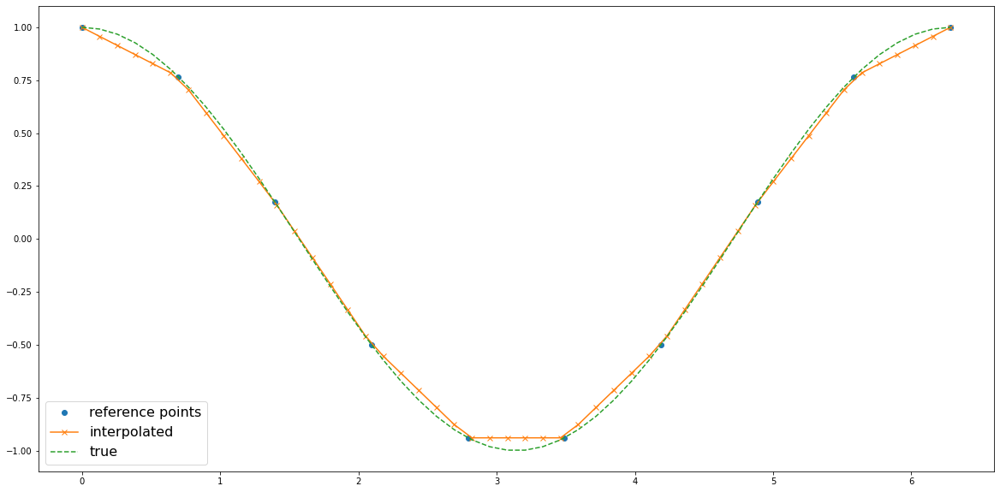

In [11]:
from PIL import Image
import numpy as np
import matplotlib.pylab as plt

im = Image.open('images/Chapter 01/Figure 3.jpg') # assumed pixel values in [0,255]
print(np.max(im))

# #### Interpolation with numpy interp() function

x_p = np.linspace(0, 2*np.pi, 10) # generate sequence of 10 points (numbers) evenly spaced in the interval [0, 2π] 

y_p = np.cos(x_p)

x = np.linspace(0, 2*np.pi, 50) # generate sequence of 50 test points (numbers) evenly spaced in the interval [0, 2π]

y = np.cos(x)

y_interp = np.interp(x, x_p, y_p)

plt.figure(figsize=(20,10)) 
plt.plot(x_p, y_p, 'o', label='reference points')
plt.plot(x, y_interp, '-x', label='interpolated')
plt.plot(x, y, '--', label='true')
plt.legend(prop={'size': 16})
plt.show()



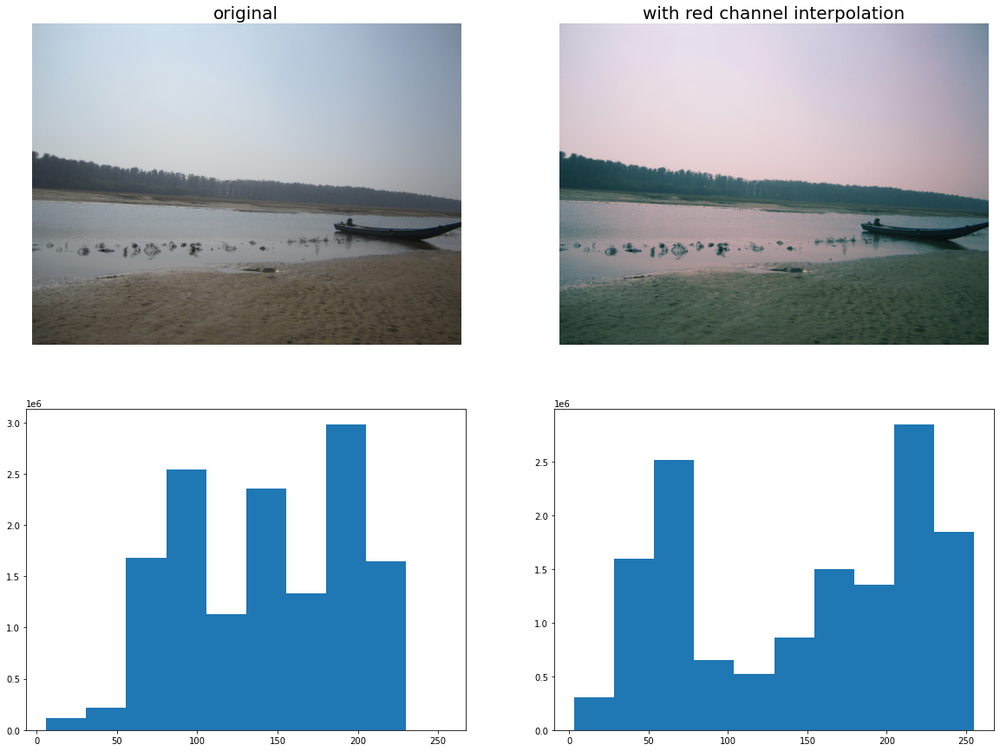

In [13]:
r, g, b = im.split() # split the channels into red, green and blue
r_old = np.linspace(0,255,11)   # reference points
r_new = [0., 12.75, 25.5, 51., 76.5, 127.5, 178.5, 204., 229.5, 242.25, 255.] # new values at reference points

r1 = Image.fromarray((np.reshape(np.interp(np.array(r).ravel(), r_old, r_new),
                                 (im.height, im.width))).astype(np.uint8), mode='L')

plt.figure(figsize=(20,15))
plt.subplot(221)
plt.imshow(im)
plt.title('original', size=20)
plt.axis('off')
plt.subplot(222)
im1 = Image.merge('RGB', (r1, g, b))
plt.imshow(im1)
plt.axis('off')
plt.title('with red channel interpolation', size=20)
plt.subplot(223)
plt.hist(np.array(r).ravel(), stacked=True)
plt.subplot(224)
plt.hist(np.array(r1).ravel(), stacked=True)
plt.show()

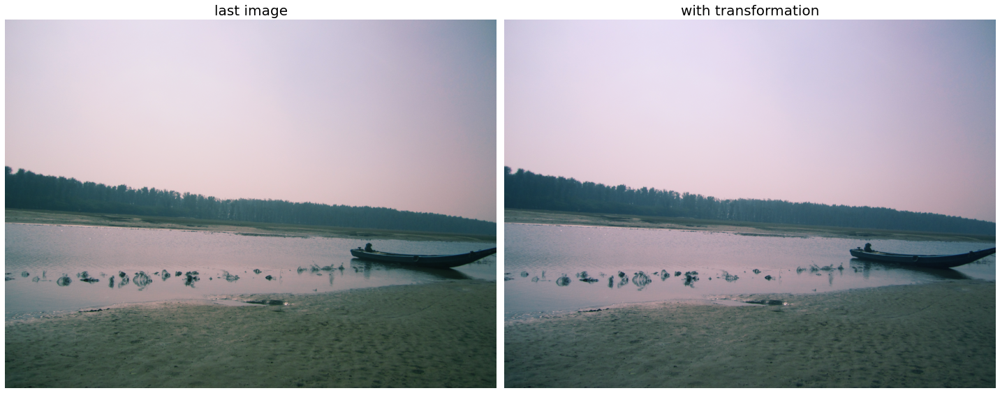

In [14]:
plt.figure(figsize=(20,10))
plt.subplot(121)
plt.imshow(im1)
plt.title('last image', size=20)
plt.axis('off')
b1 = Image.fromarray(np.clip(np.array(b) + 7.65, 0, 255).astype(np.uint8))
im1 = Image.merge('RGB', (r1, g, b1))
plt.subplot(122)
plt.imshow(im1)
plt.axis('off')
plt.title('with transformation', size=20)
plt.tight_layout()
plt.show()

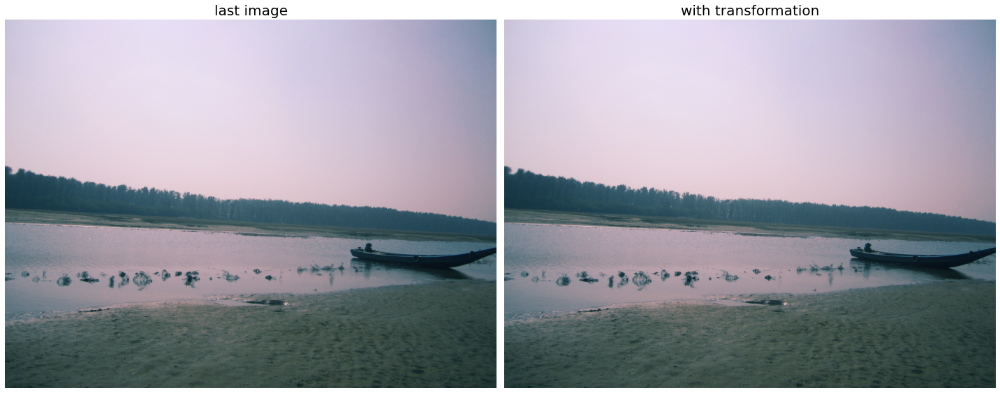

In [15]:
from PIL.ImageEnhance import Sharpness

plt.figure(figsize=(20,10))
plt.subplot(121)
plt.imshow(im1)
plt.title('last image', size=20)
plt.axis('off')
im2 = Sharpness(im1).enhance(3.0)
plt.subplot(122)
plt.imshow(im2)
plt.axis('off')
plt.title('with transformation', size=20)
plt.tight_layout()
plt.show()

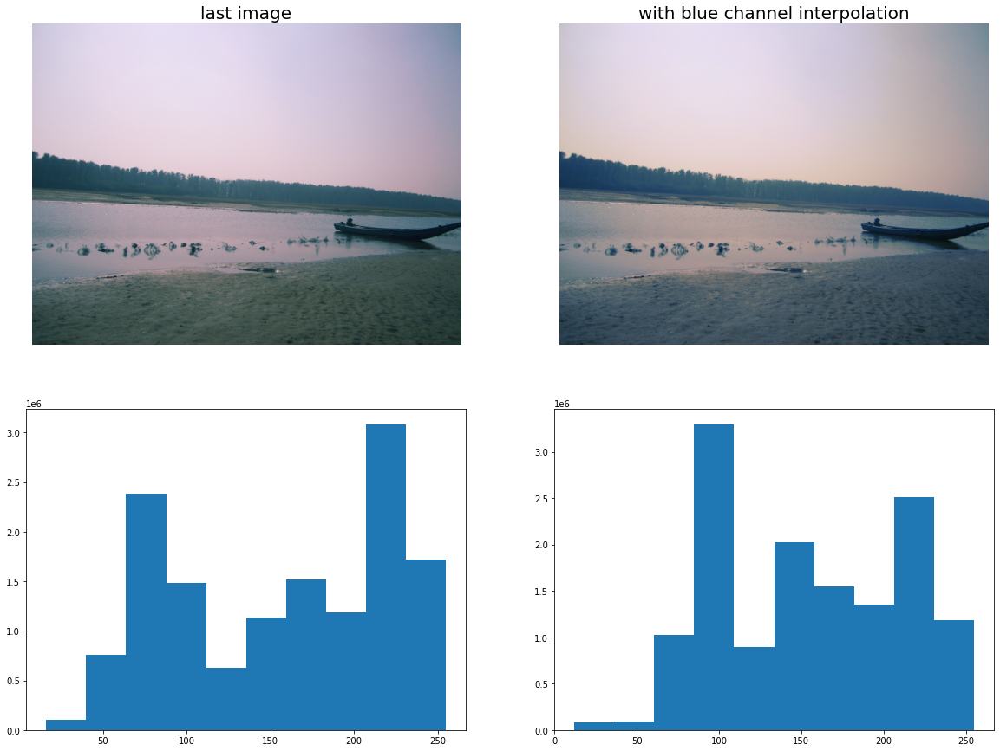

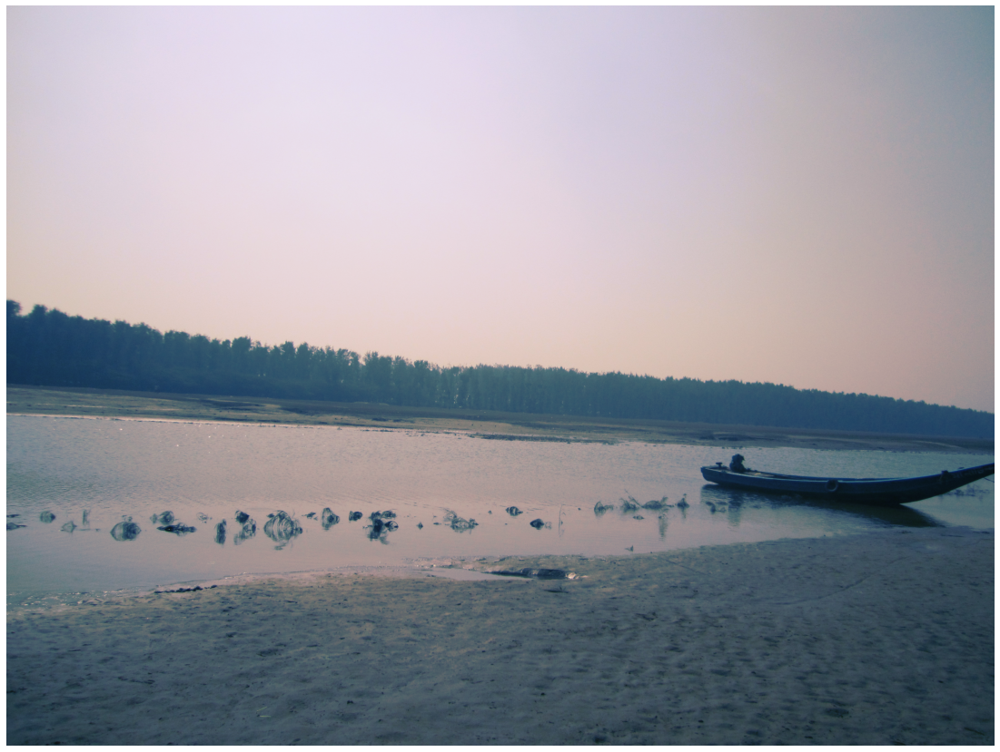

In [17]:
blue_old = np.linspace(0,255,17) # pixel values at reference points
blue_new = [0., 11.985, 30.09, 64.005, 81.09, 99.96, 107.1, 111.945, 121.125, 143.055, 147.9, 159.885, 171.105, 
               186.915, 215.985, 235.875, 255.] # new pixel values at the reference points

b2 = Image.fromarray((np.reshape(np.interp(np.array(b1).ravel(), blue_old, blue_new), 
                                 (im.height, im.width))).astype(np.uint8), mode='L')

plt.figure(figsize=(20,15))
plt.subplot(221)
plt.imshow(im2)
plt.title('last image', size=20)
plt.axis('off')
plt.subplot(222)
im3 = Image.merge('RGB', (r1, g, b2))
plt.imshow(im3)
plt.axis('off')
plt.title('with blue channel interpolation', size=20)
plt.subplot(223)
plt.hist(np.array(b1).ravel(), stacked=True)
plt.subplot(224)
plt.hist(np.array(b2).ravel(), stacked=True)
plt.show()

plt.figure(figsize=(20,15))
plt.imshow(im3)
plt.axis('off')
plt.show()

## 4. Explore image manipulations with different python libraries

### 4.1 Plot image montage with scikit-image

/var/folders/9v/jr20lh896vggl5_25dthcsw80000gn/T/ipykernel_50421/3025407571.py:12: FutureWarning: `multichannel` is a deprecated argument name for `montage`. It will be removed in version 1.0. Please use `channel_axis` instead.
  noisy_images_montage = montage(noisy_images, rescale_intensity=True, multichannel=True) # create montage


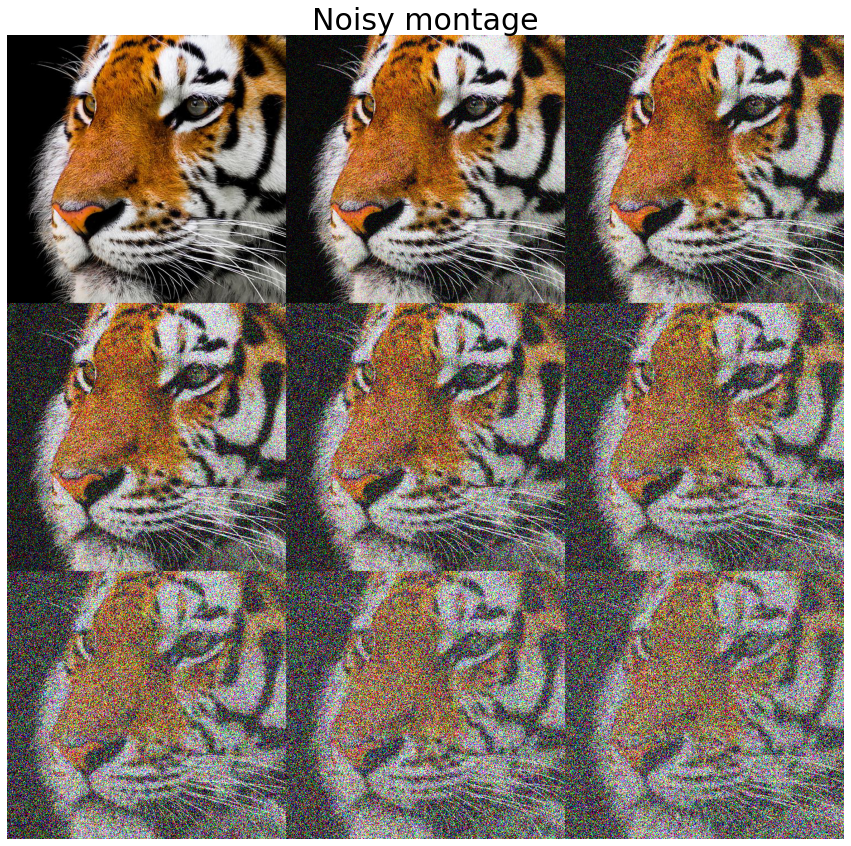

In [18]:
from skimage.io import imread
from skimage.util import random_noise, montage
import matplotlib.pylab as plt
import numpy as np
im = imread("images/Chapter 01/Figure 4.jpg")

sigmas = np.linspace(0, 1, 9) # create 9 standard deviation values in the increasing order starting from 0 to 1
noisy_images = np.zeros((9, im.shape[0], im.shape[1], im.shape[2]))
for i in range(len(sigmas)): 
    noisy_images[i,:,:,:] = random_noise(im, var=sigmas[i]**2) # add Gaussian random noise to image with different sigma values

noisy_images_montage = montage(noisy_images, rescale_intensity=True, multichannel=True) # create montage

plt.figure(figsize=(15,15))
plt.imshow(noisy_images_montage)
plt.title('Noisy montage', size=30)
plt.axis('off')
plt.show()

### 4.2 Crop / Resize images with scipy ndimage module

(320, 475, 3) (640, 950, 3)


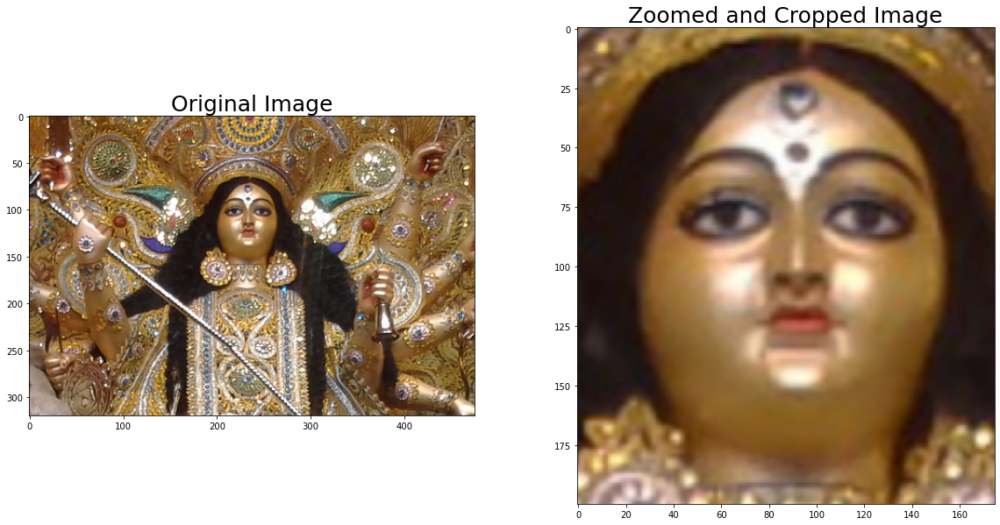

In [20]:
from scipy import ndimage
import matplotlib.pyplot as plt
from skimage.io import imread

im = imread('images/Chapter 01/Figure 5.jpg') / 255
zoomed_im = ndimage.zoom(im, (2,2,1), mode='nearest', order=1) # no zoom on color channel, order of the spline interpolation = 1
print(im.shape, zoomed_im.shape)

plt.figure(figsize=(20,10))
plt.subplot(121)
plt.imshow(im)
plt.title('Original Image', size=25)
plt.subplot(122)
plt.imshow(zoomed_im[125:325,375:550,:]) # crop the enlarged face
plt.title('Zoomed and Cropped Image', size=25)
plt.show()

### 4.3  Draw contours with opencv-python

Number of Contours found with Canny edges = 967
Number of Contours found with threshold = 640


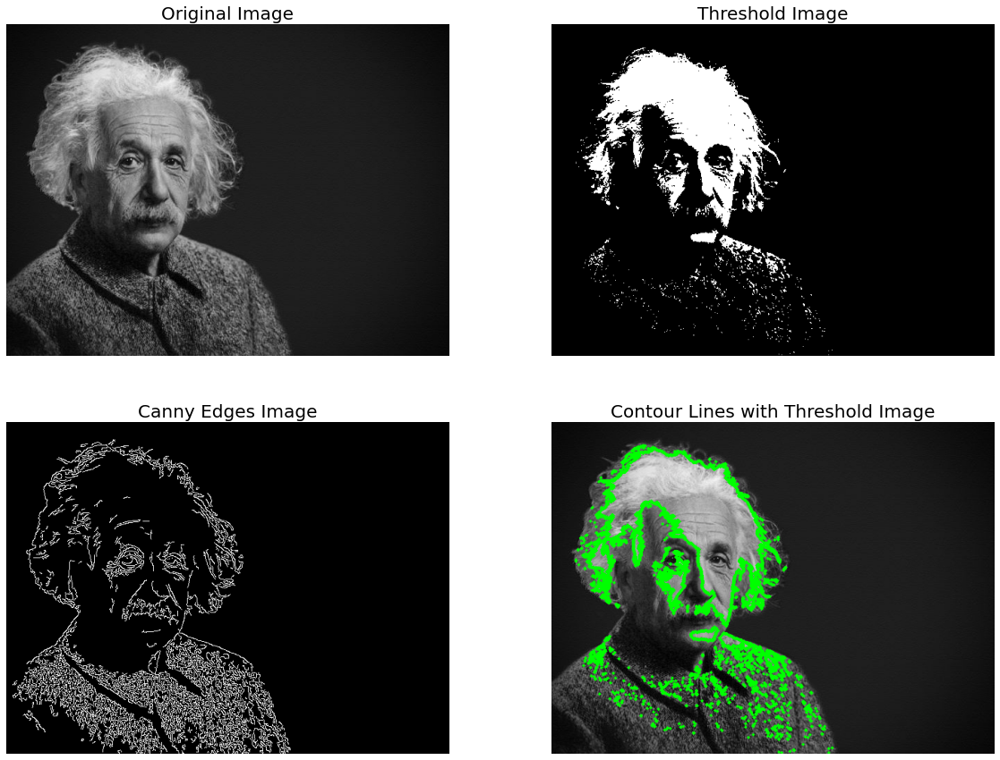

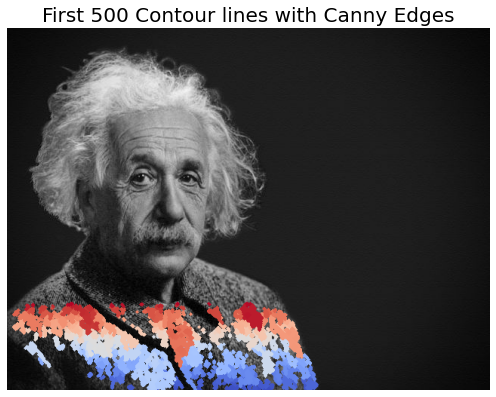

In [21]:
import cv2
import numpy as np
import matplotlib.pylab as plt

image = cv2.imread("images/Chapter 01/Figure 6.jpg")
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB) # convert from cv2 BGR to matplotlib RGB

gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
edged = cv2.Canny(gray, 125, 250)
contours_edged, _ = cv2.findContours(edged, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
print("Number of Contours found with Canny edges = " + str(len(contours_edged)))

ret, thresh = cv2.threshold(gray, 127, 255, 0)
contours_thresh, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)
print("Number of Contours found with threshold = " + str(len(contours_thresh)))

plt.figure(figsize=(20,15))
plt.subplot(221), plt.imshow(image), plt.title('Original Image', size=20), plt.axis('off')
plt.subplot(222), plt.imshow(thresh, cmap='gray'), plt.title('Threshold Image', size=20), plt.axis('off')
plt.subplot(223), plt.imshow(edged, cmap='gray'), plt.title('Canny Edges Image', size=20), plt.axis('off')
plt.subplot(224), plt.imshow(cv2.drawContours(np.copy(image), contours_thresh, -1, (0,255,0), 3))
plt.title('Contour Lines with Threshold Image', size=20), plt.axis('off')

n = 500
plt.figure(figsize=(7,7))
colors = plt.cm.coolwarm(np.linspace(0, 1, n))
for i in range(n):
    image = cv2.drawContours(image, contours_edged, i, 255*colors[i], 3)
plt.imshow(image)
plt.title('First ' + str(n) + ' Contour lines with Canny Edges', size=20), plt.axis('off')
plt.tight_layout()
plt.show()

### 4.4 Creating different Hatched Contour Patterns for different levels with matplotlib

/var/folders/9v/jr20lh896vggl5_25dthcsw80000gn/T/ipykernel_50421/3891232204.py:13: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. This has been deprecated since 3.3 and in 3.6, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = mpl.cm.get_cmap("gray").copy()
  cs.cmap.set_over('red')
/var/folders/9v/jr20lh896vggl5_25dthcsw80000gn/T/ipykernel_50421/3891232204.py:14: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. This has been deprecated since 3.3 and in 3.6, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = mpl.cm.get_cmap("gray").copy()
  cs.cmap.set_under('blue')


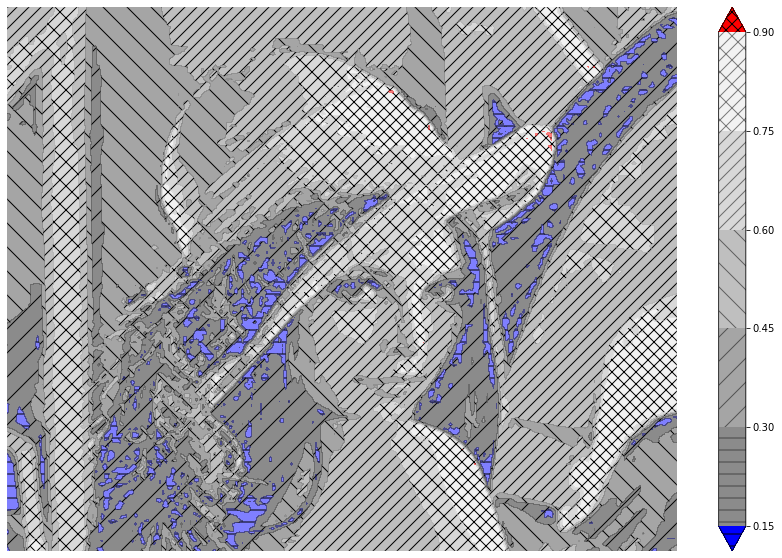

In [22]:
from skimage.io import imread
from skimage.color import rgb2gray

img = rgb2gray(imread('images/Chapter 01/Figure 1.jpg'))

y = np.arange(img.shape[0]) 
x = np.arange(img.shape[1]) 
x, y = np.meshgrid(x, y)
z = img

plt.figure(figsize=(15,10))
cs = plt.contourf(x, img.shape[0]-y, z, hatches=['-', '/', '\\', '//', '//\\', '//\\\\'], cmap='gray', extend='both', levels=6, alpha=0.5)
cs.cmap.set_over('red')
cs.cmap.set_under('blue')
cs.changed()
plt.colorbar()
plt.axis('off')
plt.show()

### 4.5 Counting Objects in an image

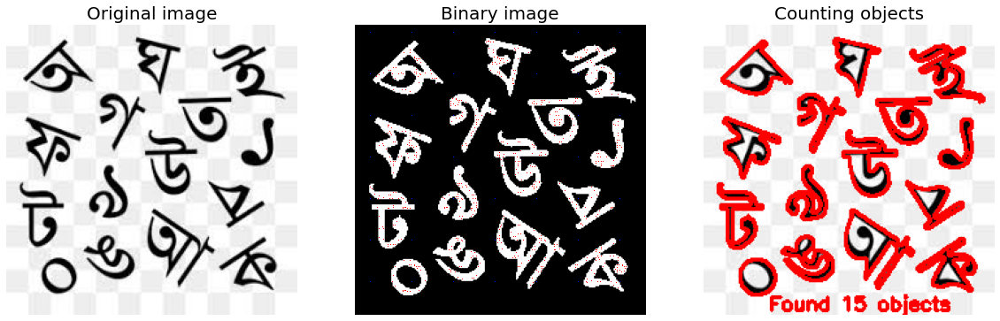

In [26]:
import cv2
import numpy as np
import matplotlib.pylab as plt

image = cv2.imread('images/Chapter 01/Figure 12.jpg')
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
edged = cv2.Canny(gray, 75, 150)

thresh = cv2.threshold(gray, 215, 255, cv2.THRESH_BINARY_INV)[1]
kernel = np.ones((2,2),np.uint8)
thresh = cv2.morphologyEx(thresh, cv2.MORPH_CLOSE, kernel)

cnts, _ = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
output = image.copy()

for c in cnts:
    # draw each contour on the output image with a 3px thick red
    # outline, then display the output contours one at a time
    cv2.drawContours(output, [c], -1, (0, 0, 255), 2) 

text = "Found {} objects".format(len(cnts))
cv2.putText(output, text, (50, 220),  cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 2)
plt.figure(figsize=(20,7))
plt.subplot(131), plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB)), plt.axis('off'), plt.title('Original image', size=20)
plt.subplot(132), plt.imshow(thresh, cmap='gray'), plt.axis('off'), plt.title('Binary image', size=20)
plt.subplot(133), plt.imshow(cv2.cvtColor(output, cv2.COLOR_BGR2RGB)), plt.axis('off'), plt.title('Counting objects', size=20)
plt.show()

### 4.6 Convert a png image with palette to gray scale with PIL

P


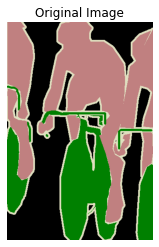

L


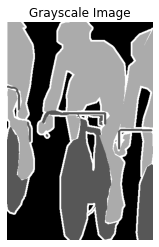

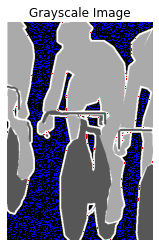

In [29]:
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

img = Image.open('images/Chapter 01/Figure 7.png')
print(img.mode)

plt.imshow(img)
plt.axis('off')
plt.title('Original Image')
plt.show()

img = img.convert('RGB').convert('L')
print(img.mode)
plt.imshow(img, cmap='gray')
plt.axis('off')
plt.title('Grayscale Image')
plt.show()

import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

def rgb2gray(R, G, B):
    return 0.2989 * R + 0.5870 * G + 0.1140 * B 

img = Image.open('images/Chapter 01/Figure 7.png') # filename is the png file in question
pal = img.getpalette()     # get the palette

arr = np.zeros((img.height, img.width)) # initialize the output image with zero values
for i in range(arr.shape[0]):
    for j in range(arr.shape[1]):
        idx = img.getpixel((j,i)) # get the index of the pixel in the palette
        R, G, B = pal[3*idx], pal[3*idx+1], pal[3*idx+2] # get the R,G,B values of the pixel
        arr[i,j] = rgb2gray(R, G, B) # convert to grayscale

plt.imshow(arr, cmap='gray')
plt.title('Grayscale Image')
plt.axis('off')
plt.show()

### 4.7 Different ways to convert an RGB image to GrayScale

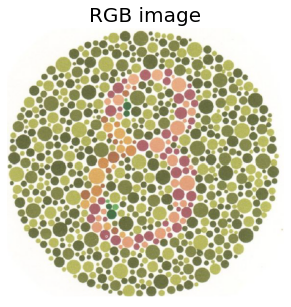

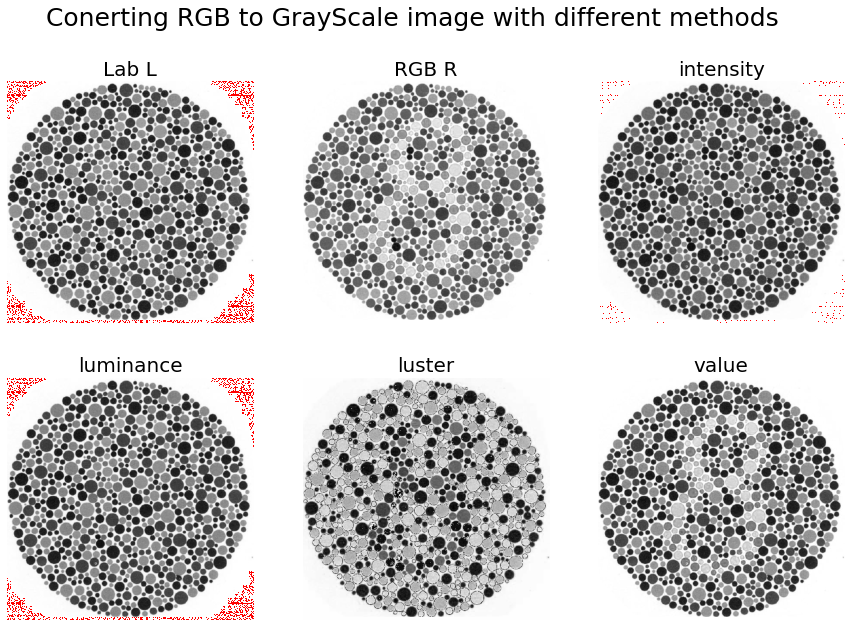

In [30]:
import numpy as np
from skimage.color import rgb2lab
from skimage.io import imread
import matplotlib.pylab as plt

def rgb2gray(img):
    gray_images = {}
    gray_images['intensity'] = np.mean(image, axis=2)
    gray_images['luminance'] = np.average(image, axis=2, weights=[0.3, 0.59, 0.11])
    gray_images['value'] = np.max(image, axis=2)
    gray_images['luster'] = (np.max(image, axis=2) + np.min(image, axis=2)) / 2
    gray_images['Lab L'] = rgb2lab(img)[...,0]
    gray_images['RGB R'] = img[...,0]
    return gray_images

image = imread('images/Chapter 01/Figure 17.png')
plt.figure(figsize=(5,5))
plt.imshow(image), plt.axis('off'), plt.title('RGB image', size=20)
plt.show()

gray_images = rgb2gray(image)
i = 1
plt.figure(figsize=(15,10))
plt.gray()
for gray_type in sorted(gray_images):
    plt.subplot(2,3,i), plt.imshow(gray_images[gray_type]), plt.axis('off'), plt.title(gray_type, size=20)
    i += 1
plt.suptitle('Conerting RGB to GrayScale image with different methods', size=25)
plt.show()

### 4.8 Image Differences with PIL

In [31]:
from PIL.ImageChops import difference
from PIL import Image

im1 = Image.open("images/Chapter 01/Figure 8.jpg")
im2 = Image.open("images/Chapter 01/Figure 9.jpg").resize((im1.width, im1.height))

difference(im2, im1).show()
difference(im2, im1).save('images/Chapter 01/Figure 16.jpg')


### 4.9 RGB to hsv and Yuv color spaces with scikit-image

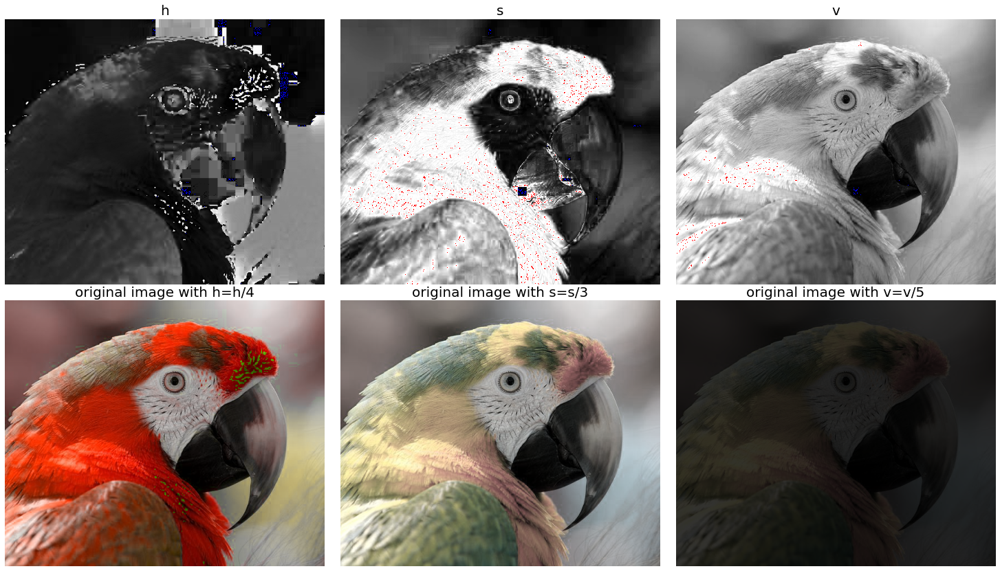

In [32]:
from skimage.io import imread
from skimage.color import rgb2hsv, hsv2rgb
import numpy as np
import matplotlib.pyplot as plt

im = imread("images/Chapter 01/Figure 11.jpg")
im_hsv = np.clip(rgb2hsv(im), 0, 1)

plt.figure(figsize=(20,12))
plt.subplots_adjust(0,0,1,0.925,0.05,0.05)
plt.gray()
plt.subplot(231), plt.imshow(im_hsv[...,0]), plt.title('h', size=20), plt.axis('off')
plt.subplot(232), plt.imshow(im_hsv[...,1]), plt.title('s', size=20), plt.axis('off')
plt.subplot(233), plt.imshow(im_hsv[...,2]), plt.title('v', size=20), plt.axis('off')
im_hsv_copy = np.copy(im_hsv)
im_hsv[...,0] /= 4
plt.subplot(234), plt.imshow(np.clip(hsv2rgb(im_hsv), 0, 1)), plt.title('original image with h=h/4', size=20), plt.axis('off')
im_hsv = im_hsv_copy
im_hsv[...,1] /= 3
plt.subplot(235), plt.imshow(np.clip(hsv2rgb(im_hsv), 0, 1)), plt.title('original image with s=s/3', size=20), plt.axis('off')
im_hsv = im_hsv_copy
im_hsv[...,2] /= 5
plt.subplot(236), plt.imshow(np.clip(hsv2rgb(im_hsv), 0, 1)), plt.title('original image with v=v/5', size=20), plt.axis('off')
plt.show()

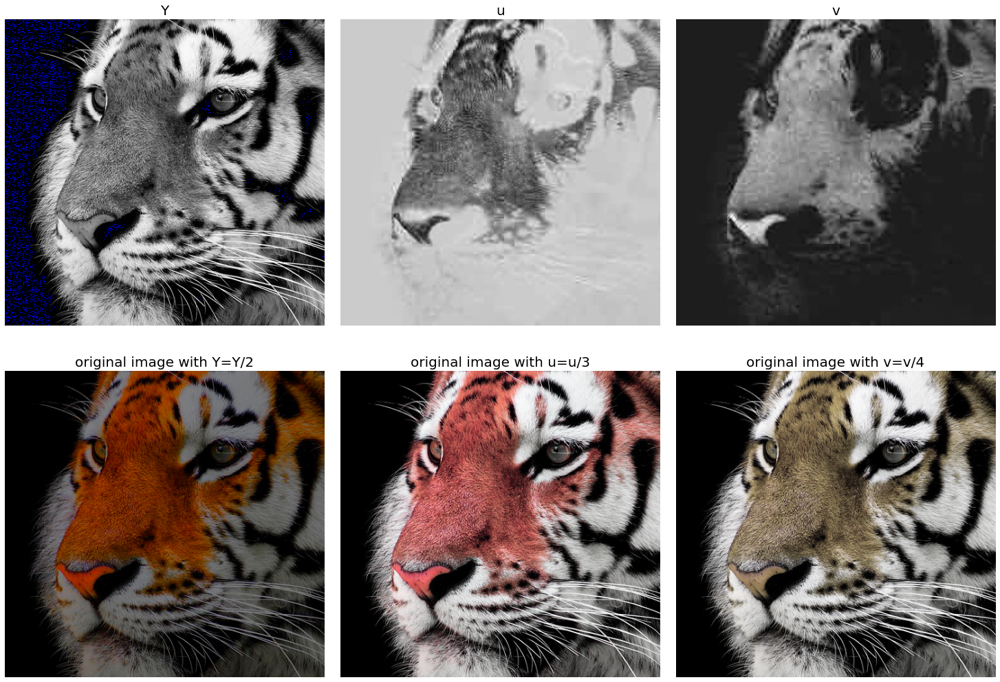

In [33]:
from skimage.color import rgb2yuv, yuv2rgb

im = imread("images/Chapter 01/Figure 4.jpg")
im_Yuv = rgb2yuv(im)

plt.figure(figsize=(20,15))
plt.subplots_adjust(0,0,1,0.925,0.05,0.05)
plt.gray()
plt.subplot(231), plt.imshow(im_Yuv[...,0]), plt.title('Y', size=20), plt.axis('off')
plt.subplot(232), plt.imshow(im_Yuv[...,1]), plt.title('u', size=20), plt.axis('off')
plt.subplot(233), plt.imshow(im_Yuv[...,2]), plt.title('v', size=20), plt.axis('off')
im_Yuv_copy = np.copy(im_Yuv)
im_Yuv[...,0] /= 2
plt.subplot(234), plt.imshow(np.clip(yuv2rgb(im_Yuv),0,1)), plt.title('original image with Y=Y/2', size=20), plt.axis('off')
im_Yuv = im_Yuv_copy
im_Yuv[...,1] /= 3
plt.subplot(235), plt.imshow(np.clip(yuv2rgb(im_Yuv),0,1)), plt.title('original image with u=u/3', size=20), plt.axis('off')
im_Yuv = im_Yuv_copy
im_Yuv[...,2] /= 4
plt.subplot(236), plt.imshow(np.clip(yuv2rgb(im_Yuv),0,1)), plt.title('original image with v=v/4', size=20), plt.axis('off')
plt.show()

### 4.10 Resizing an image with opencv-python

(55, 55, 3) (220, 220, 3)


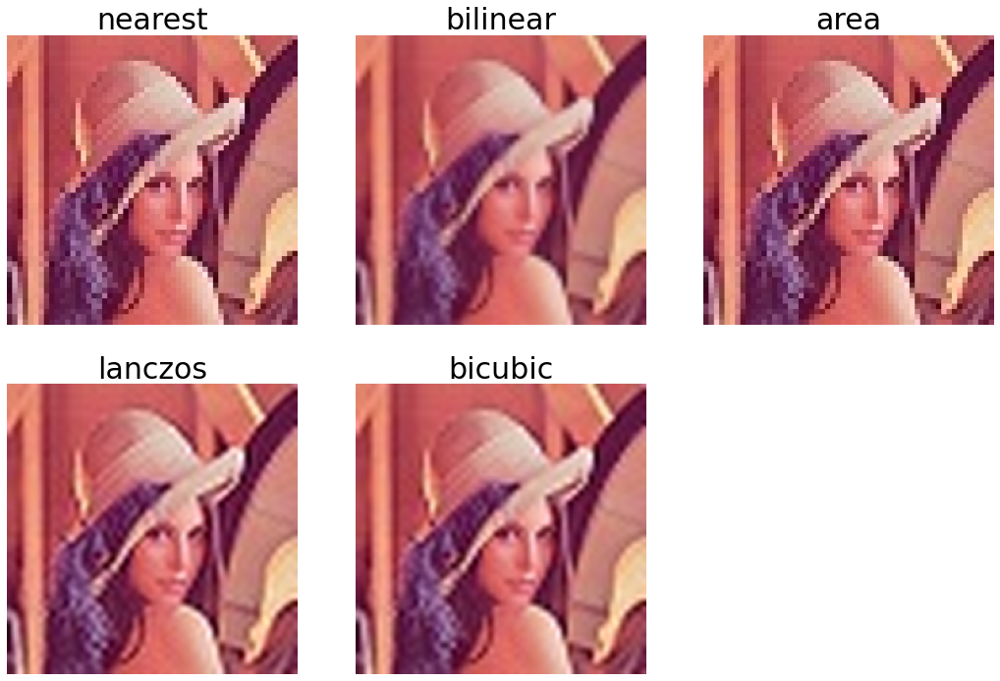

In [19]:
import cv2
import matplotlib.pylab as plt
im = cv2.imread("images/Chapter 01/Figure 10.jpg") 
interps = ['nearest', 'bilinear', 'area', 'lanczos', 'bicubic']

i = 1
plt.figure(figsize=(18,12))
for interp in [cv2.INTER_NEAREST, cv2.INTER_LINEAR, cv2.INTER_AREA, cv2.INTER_LANCZOS4, cv2.INTER_CUBIC]:
 im1 = cv2.resize(im, None, fx=4., fy=4., interpolation = interp) # 4 times
 plt.subplot(2,3,i)
 plt.imshow(cv2.cvtColor(im1, cv2.COLOR_BGR2RGB))
 plt.axis('off')
 plt.title(interps[i-1], size=30)
 i += 1
print(im.shape, im1.shape)
plt.show()

### 4.11 Add a logo to an image with scikit-image

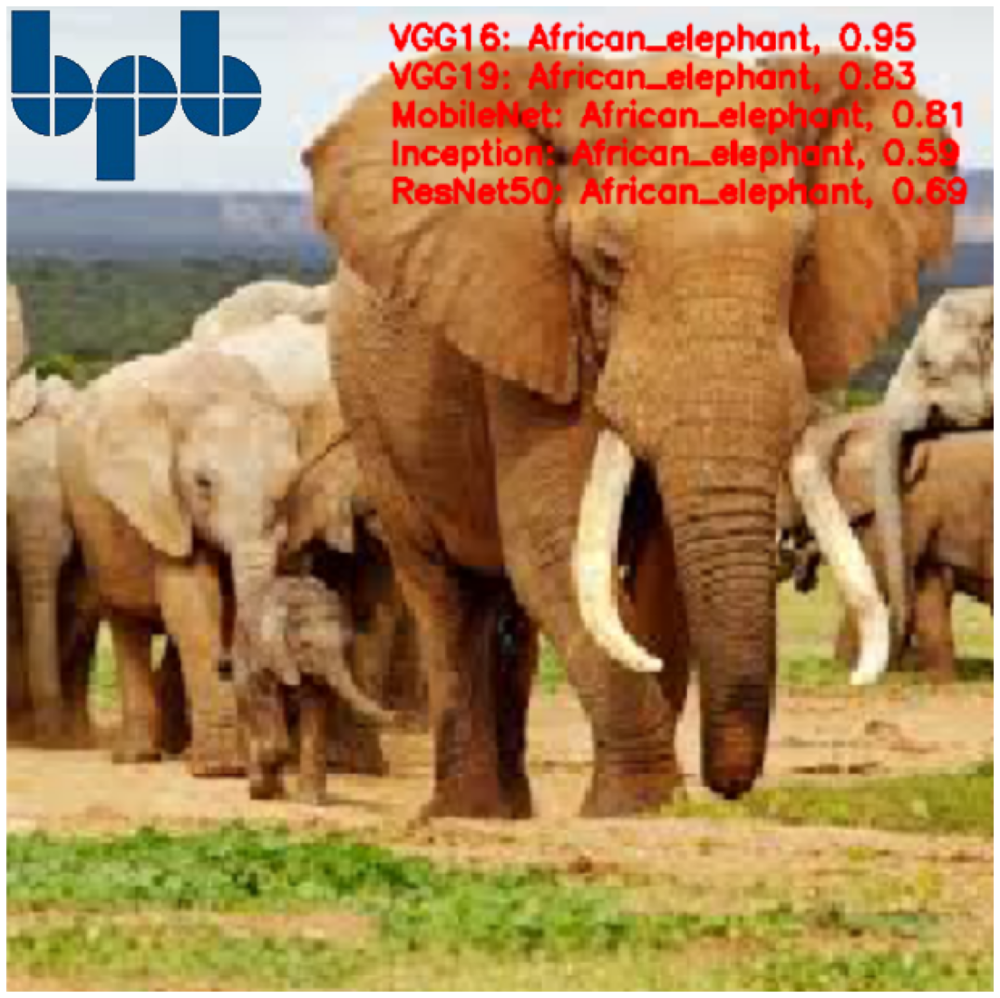

In [25]:
from skimage.io import imread
from skimage.color import rgb2gray, gray2rgb
import numpy as np
import matplotlib.pylab as plt

img1 = imread('images/Chapter 01/Figure 13.png').astype(np.uint8)
img2 = imread('images/Chapter 01/Figure 14.jpg').astype(np.uint8) # logo

rows, cols, _ = img2.shape
roi = img1[0:rows, 0:cols]

img2gray = (255*rgb2gray(img2)).astype(np.uint8)
mask = 255*(img2gray < 150) #cv2.threshold(img2gray, 10, 255, cv2.THRESH_BINARY)

mask_inv = np.invert(mask) #cv2.bitwise_not(mask)
mask_inv = mask_inv.astype(np.uint8)

img1_bg = np.bitwise_and(roi, gray2rgb(mask_inv)) #cv2.bitwise_and(roi,roi,mask = mask_inv)

img2_fg = np.bitwise_and(img2, gray2rgb(mask)) # cv2.bitwise_and(img2,img2,mask = mask)

dst = img1_bg + img2_fg
img1[0:rows, 0:cols ] = dst
plt.figure(figsize=(20,20))
plt.imshow(img1)
plt.axis('off')
plt.show()

### 4.12 Change brightness / contrast of an image with linear transform and gamma correction with opencv-python

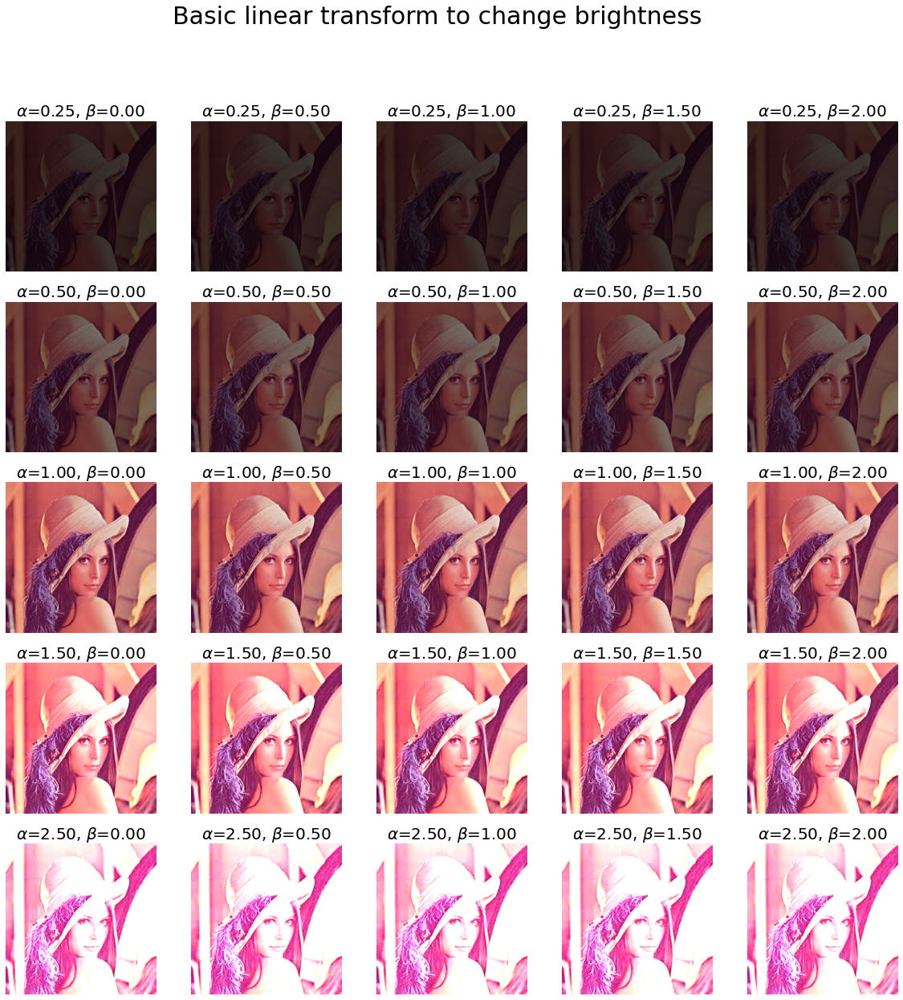

In [37]:
import cv2
import numpy as np
import matplotlib.pylab as plt

alpha, beta, gamma = 1, 0, 1

def basic_linear_transform(img, alpha, beta):
    return cv2.convertScaleAbs(img, alpha=alpha, beta=beta)

def gamma_correction(img, gamma):
    lookup_table = np.empty((1,256), np.uint8)
    for i in range(256):
        lookup_table[0,i] = np.clip(pow(i / 255.0, gamma) * 255.0, 0, 255)
    return cv2.LUT(img, lookup_table)

image = cv2.imread('images/Chapter 01/Figure 1.jpg') 

plt.figure(figsize=(20,20))
i = 1
for alpha in [0.25, 0.5, 1, 1.5, 2.5]:
    for beta in [0, 0.5, 1, 1.5, 2]:
        image_corrected = basic_linear_transform(image, alpha, beta)
        plt.subplot(5,5,i), plt.imshow(cv2.cvtColor(image_corrected, cv2.COLOR_BGR2RGB)), plt.axis('off')
        plt.title(r'$\alpha$={:.2f}, $\beta$={:.2f}'.format(alpha, beta), size=20)
        i += 1
plt.suptitle('Basic linear transform to change brightness', size=30)
plt.show()


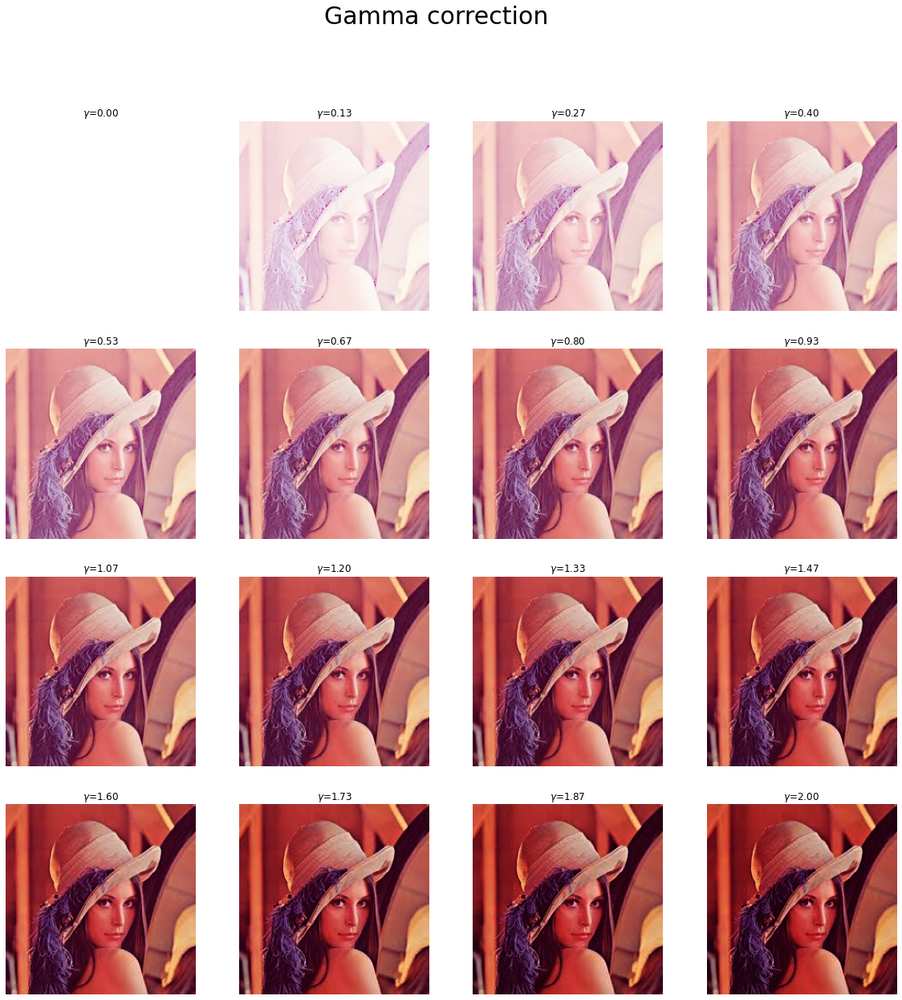

In [38]:
plt.figure(figsize=(20,20))
i = 1
for gamma in np.linspace(0, 2, 16):
    image_gamma_corrected = gamma_correction(image, gamma)
    plt.subplot(4,4,i), plt.imshow(cv2.cvtColor(image_gamma_corrected, cv2.COLOR_BGR2RGB)), plt.axis('off')
    plt.title(r'$\gamma$={:.2f}'.format(gamma))
    i += 1
plt.suptitle('Gamma correction', size=30)
plt.show()

## 5. Object Removal with Seam Carving

0.19.2
(1536, 1079, 3)


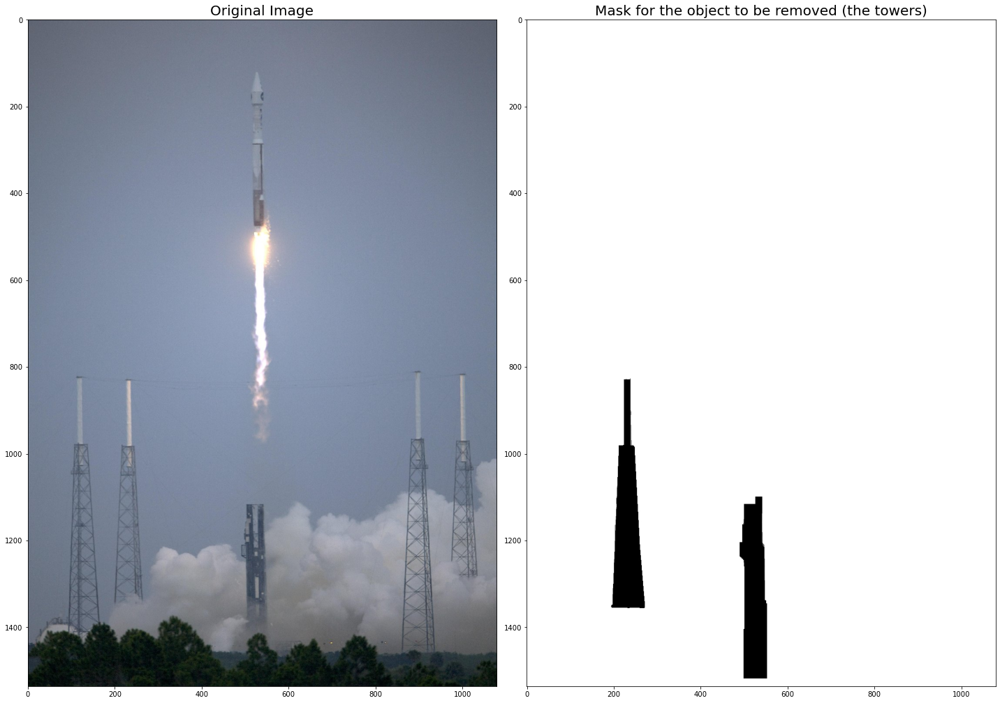

In [17]:
import skimage
print(skimage.__version__)

from skimage.io import imread
from skimage.color import rgb2gray
# from skimage.transform import seam_carve
import matplotlib.pylab as plt
from matplotlib.pyplot import imshow

from PIL import Image
import numpy as np
import seam_carving

image = imread('images/Chapter 01/Figure 27.png')
mask_image = rgb2gray(imread('images/Chapter 01/Figure 28.png'))
print(image.shape)
plt.figure(figsize=(20,20))
plt.subplot(121), plt.imshow(image), plt.title('Original Image', size=20)
plt.subplot(122), plt.imshow(mask_image, cmap='gray'), plt.title('Mask for the object to be removed (the towers)', size=20)
plt.tight_layout()
plt.show()

ValueError: zero-size array to reduction operation minimum which has no identity

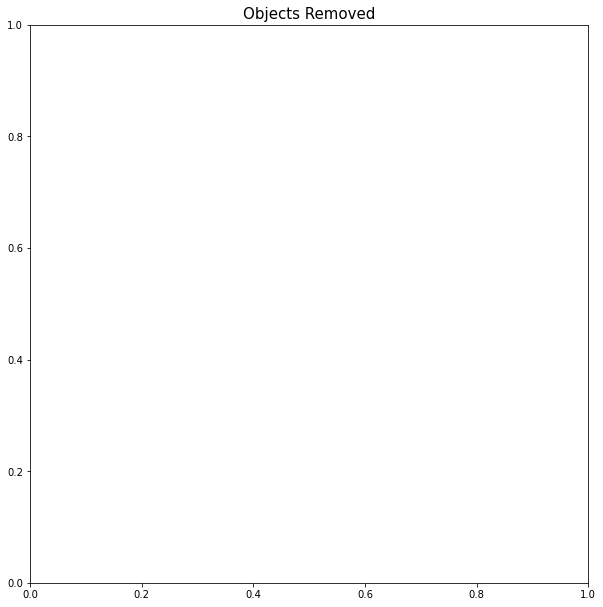

In [18]:
plt.figure(figsize=(10,15))
plt.title('Objects Removed', size=15)
image = np.array(Image.open('images/Chapter 01/Figure 27.png'))
mask_image = np.array(Image.open('images/Chapter 01/Figure 28.png').convert('L'))

# image.shape
# mask_image.shape
out = seam_carving.remove_object(image, drop_mask=mask_image, keep_mask=None)
imshow(np.asarray(out))
# # out = seam_carve(image, mask_image, 'verical', 120)
# plt.imshow(out)
# plt.show()

## 6. Create Fake Miniature Effect

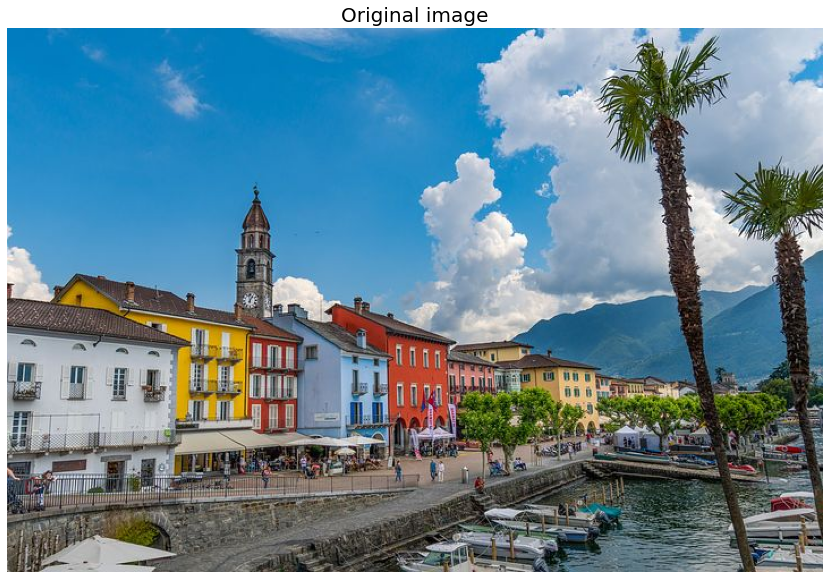

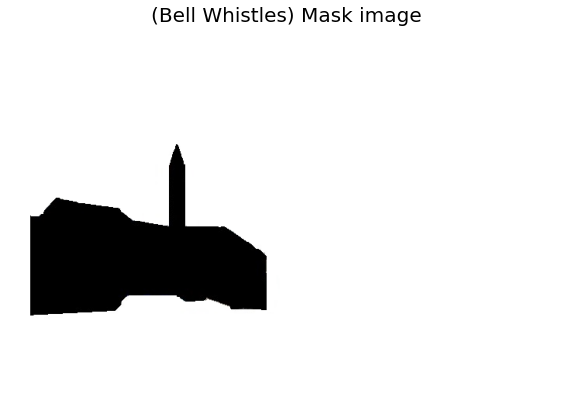

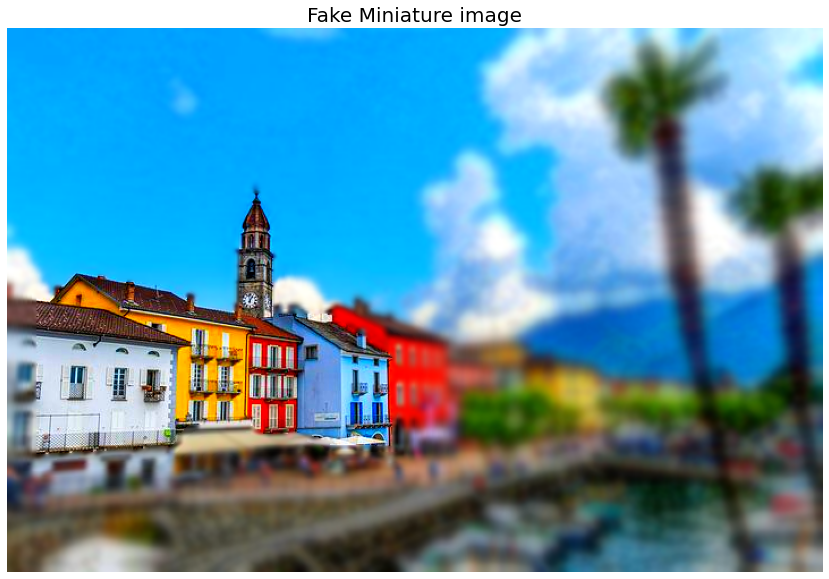

In [10]:
from PIL import Image, ImageEnhance, ImageFilter
from scipy.ndimage import binary_erosion
from PIL.ImageFilter import GaussianBlur
import matplotlib.pyplot as plt, numpy as np

def apply_gradient_blur(image, mask, n=10, radius=1):
    mask = mask.convert("1")
    for i in range(n):
        mask = binary_erosion(np.array(mask), structure=np.ones((10,10)), border_value=1)
        im_blur = image.filter(GaussianBlur(radius=radius))
        image.paste(im_blur, mask=Image.fromarray(mask))
    return image

def create_fake_miniature(im, custom_mask, color=1.9, contrast=1.4, blur_radius=1.3):
    # Cranking up the contrast and color
    edited = ImageEnhance.Contrast(ImageEnhance.Color(im).enhance(color)).enhance(contrast)
    # Blurring the image and merging
    im_blur = apply_gradient_blur(edited.copy(), mask.copy(), n=50, radius=blur_radius)
    edited = edited.convert("RGBA")
    edited.paste(im_blur, mask=mask)
    return edited

im = Image.open("images/Chapter 01/Figure 29.png")
mask = Image.open("images/Chapter 01/Figure 30.png")
out = create_fake_miniature(im, mask)
plt.figure(figsize=(20,10))
plt.imshow(im), plt.axis('off'), plt.title('Original image', size=20)
plt.show()

plt.figure(figsize=(10,10))
plt.imshow(mask), plt.axis('off'), plt.title('(Bell Whistles) Mask image', size=20)
plt.show()

plt.figure(figsize=(20,10))
plt.imshow(out), plt.axis('off'), plt.title('Fake Miniature image', size=20)
plt.show()